# Comparing samples, NK cells, density plots

In this notebook density plots are generated from CLR normalized protein counts of different NK cell markers to compare signals. In Easigenomics also DSB transformed protein counts are available, so these are visualized and compared to CLR transformed counts. 

- First, NK cells are selected based on annotations made by authors, after which only one sample from each dataset is selected => One sample, only NK (or NKT cells) visualized
- For comparisons, also objects containing only B cells from sample of interest is generated
- Additionally, isotype control data is used fro comparisons of ab signals

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap
from muon import prot as pt

from ridgeplot import ridgeplot

import warnings

warnings.filterwarnings('ignore')



Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


## Neurips

In [2]:
#Neurips
adata_neurips = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_neurips_norm_outer.h5ad')

In [3]:
neurips_prot=adata_neurips.obsm['protein_expression_clr_neurips']

In [4]:
neurips_prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,HLA-E,CD82,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15
GTAGTACCAATCCTTT-1-s4d1,0.652674,1.447594,1.489354,0.890243,1.290341,1.988618,1.733474,0.850004,1.531390,0.694828,...,1.532575,0.614600,0.900688,1.389844,0.918109,0.0,0.0,0.0,0.0,0.0
CTCAAGAGTCACAGAG-1-s4d1,0.652674,1.069339,1.657770,0.890243,1.377072,1.264995,1.863027,1.101769,1.562259,1.072649,...,1.283465,0.614600,1.786480,0.762359,1.112478,0.0,0.0,0.0,0.0,0.0
CTGTGGGTCATGCGGC-1-s4d1,0.378666,1.132949,1.153412,0.730824,1.195368,1.546005,1.090567,1.173337,1.303511,1.013739,...,1.344431,0.353792,0.860303,0.979461,1.147198,0.0,0.0,0.0,0.0,0.0
CGTGATAGTTATCTGG-1-s4d1,0.000000,1.249182,1.335424,1.256332,2.674106,1.322314,0.289336,1.240123,1.397398,1.525053,...,0.859205,1.527772,0.629556,0.854928,1.000442,0.0,0.0,0.0,0.0,0.0
AGATCCAAGATCGGTG-1-s4d1,2.784459,1.132949,1.674846,1.669058,1.663981,2.101246,2.112640,1.417276,1.884321,1.861734,...,1.429432,1.031029,2.808629,2.007436,2.064066,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTGGTTAGTCGAGTTT-1-s1d3,0.000000,0.175083,0.734526,0.000000,0.505917,1.235054,1.241451,0.512721,0.502246,1.766372,...,0.374154,0.425643,0.519947,0.484666,0.497623,0.0,0.0,0.0,0.0,0.0
GCTACAACAGTGCGCT-1-s1d3,0.378666,0.453643,0.894450,0.000000,0.766577,1.058199,1.529611,0.512721,0.663922,1.766372,...,1.074485,0.100854,1.415230,0.854928,0.560915,0.0,0.0,0.0,0.0,0.0
AACAAAGGTTGGTACT-1-s1d3,0.378666,0.324031,1.094684,0.306698,0.401377,1.983838,2.156735,0.512721,0.835018,2.400949,...,1.149104,1.324148,1.315806,0.605141,0.357584,0.0,0.0,0.0,0.0,0.0
TGACAGTCATGGCTGC-1-s1d3,0.378666,0.764571,0.776968,0.306698,0.152401,1.358780,1.753042,0.201533,0.586348,1.543085,...,1.373575,0.276377,1.113769,0.660339,0.960123,0.0,0.0,0.0,0.0,0.0


In [5]:
#Select only NK cells

neurips_nk = adata_neurips[(adata_neurips.obs['cell_type'] == "NK") | (adata_neurips.obs['cell_type'] == "NK CD158e1+")]

In [6]:
#Select only B cells

neurips_b=adata_neurips[adata_neurips.obs['cell_type'] == 'Naive CD20+ B IGKC+' ]

In [7]:
neurips_b

View of AnnData object with n_obs × n_vars = 3835 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [8]:
neurips_nk

View of AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [9]:
neurips_sample = neurips_nk[neurips_nk.obs['POOL'] == 's4d1']

In [10]:
neurips_sample_b = neurips_b[neurips_b.obs['POOL'] == 's4d1']

In [11]:
neurips_sample

View of AnnData object with n_obs × n_vars = 665 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [12]:
neurips_sample_b

View of AnnData object with n_obs × n_vars = 286 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [13]:
#protein counts of selected sample
neurips_nk_prot=neurips_sample.obsm['protein_expression_clr_neurips']

In [14]:
#isotype control counts of selected sample (only NK cells)
neurips_isotype=neurips_sample.obsm['ADT_isotype_controls']

In [15]:
neurips_isotype

,Mouse-IgG1,Mouse-IgG2a,Mouse-IgG2b,Rat-IgG2b,Rat-IgG1,Rat-IgG2a
GTAGTACCAATCCTTT-1-s4d1,0.371773,0.415173,0.371773,0.062345,0.176461,0.228980
CTGTGGGTCATGCGGC-1-s4d1,0.533398,0.162271,0.424311,0.301850,0.000000,0.424311
GCAACATTCGCAAGAG-1-s4d1,0.677794,0.592188,0.448242,0.077696,0.217030,0.077696
TCACGGGTCGCACGAC-1-s4d1,0.521819,0.186917,0.480314,0.186917,0.242190,0.480314
CGCCAGAAGACCATTC-1-s4d1,0.763261,0.386335,0.431098,0.386335,0.339475,0.126401
...,...,...,...,...,...,...
CCGGACAAGGCCCACT-1-s4d1,0.874242,0.686202,0.505273,0.152171,0.284215,0.505273
CGTGATACACGACCTG-1-s4d1,0.501835,0.501835,0.397979,0.341704,0.549980,0.218659
GTTCTATCACGTCGGT-1-s4d1,0.682811,0.361377,0.626263,0.196924,0.103302,0.103302
TAGATCGTCTCTATAC-1-s4d1,0.306659,0.407083,0.541018,0.252393,0.306659,0.195013


In [16]:
#protein counts of selected sample (sample with only B cells)
neurips_b_prot=neurips_sample_b.obsm['protein_expression_clr_neurips']

## Granja

In [17]:
adata_granja = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_granja_norm.h5ad')


In [18]:
#Select NK cells

granja_nk=adata_granja[adata_granja.obs['new_cell_type'] == 'NK' ]

In [19]:
granja_nk.obs['POOL'].unique().tolist()

['GSM4138872', 'GSM4138873']

In [20]:
#selecting sample
granja_sample = granja_nk[granja_nk.obs['POOL'] == 'GSM4138872']

In [21]:
granja_sample.shape

(517, 8051)

In [22]:
granja_nk_prot=granja_sample.obsm['protein_expression_clr_granja']

granja_nk_prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15,CD117,CD66ace
BMMC_D1T1:AAAGAACTCGAAGAAT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.346739,0.0,0.0
BMMC_D1T1:AAAGGGCAGAAGTGTT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.927923,0.0,0.0
BMMC_D1T1:AAAGTCCGTCGGAAAC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.890060,0.0,0.0
BMMC_D1T1:AAAGTGAGTTACCCAA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.346739,0.0,0.0
BMMC_D1T1:AACAAAGAGTCTGCGC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.016744,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BMMC_D1T1:TTTCCTCTCCCGAGGT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.154133,0.0,0.0
BMMC_D1T1:TTTGATCTCGGATTAC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.999600,0.0,0.0
BMMC_D1T1:TTTGGTTTCTCGCAGG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.946329,0.0,0.0
BMMC_D1T1:TTTGTTGGTGCAACAG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.744967,0.0,0.0


In [23]:
#To exclude columns that contain only zeros

granja_nk_prot = pd.DataFrame(granja_nk_prot)
granja_nk_prot != 0
(granja_nk_prot != 0).any(axis=0)
granja_nk_prot.loc[:, (granja_nk_prot != 0).any(axis=0)]
granja_nk_prot = granja_nk_prot.loc[:, (granja_nk_prot != 0).any(axis=0)]


## Easigenomics

### Comments:

- Only NKT annotation available (NK- + T-cells)

In [24]:
adata_easi = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_easi_norm.h5ad')

In [25]:
#Select NK + T

easi_nkt=adata_easi[adata_easi.obs['cell_type'] == 'NKT' ]

In [26]:
easi_nkt

View of AnnData object with n_obs × n_vars = 27738 × 8051
    obs: 'cell_type', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'eg_code', 'leiden_r1', 'new_cell_type', 'batch_group'
    uns: 'neighbors', 'new_cell_type_colors', 'umap'
    obsm: 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr', 'protein_expression_dsb'
    obsp: 'connectivities', 'distances'

In [27]:
#selecting sample
easi_sample = easi_nkt[easi_nkt.obs['POOL'] == 'EG35']

In [28]:
easi_sample.shape

(1226, 8051)

In [29]:
#CLR normalized protein counts

easi_nkt_prot=easi_sample.obsm['protein_expression_clr']

easi_nkt_prot

,CD19,CD10,CD20,CD3,CD2,CD11b,HLADR,CD38,CD11c,CD7,...,CD5,CD15,CD64,CD117,CD24,CD44,CD58,CD66ace,CD13,CD34
AAACCTGAGCCCTAAT-1-100,0.478646,0.589328,0.507486,0.418344,1.800515,0.735300,0.821979,0.386772,0.779578,1.667181,...,0.507486,1.108744,0.640390,0.418344,0.285596,2.054122,0.589328,0.779578,0.285596,0.779578
AAACCTGCAGACGCTC-1-100,0.332147,0.357515,0.694546,0.540162,1.879650,0.600883,0.888949,0.453003,0.694546,2.364060,...,1.135601,1.039049,0.164727,0.406398,0.382255,2.121294,0.429972,0.560815,0.194650,0.796464
AAACCTGTCCTTAATC-1-100,0.363054,0.530829,0.530829,0.363054,1.853775,0.651907,0.800025,0.332136,0.857352,1.225956,...,1.088464,0.838606,0.422162,0.363054,0.267275,2.193482,0.696512,0.556246,0.123380,0.780162
AAACGGGGTCTCTCGT-1-100,0.345256,0.537805,0.469869,0.699197,2.790828,0.580660,0.735780,0.290712,0.559462,1.266690,...,1.055818,0.960086,0.345256,0.233019,0.371452,3.018252,0.345256,0.661225,0.139715,0.580660
AAAGATGTCCAGTAGT-1-100,0.318489,0.283800,0.171871,0.611861,2.949483,0.878145,0.817923,0.352015,0.636968,0.731533,...,0.775660,1.164216,0.318489,0.504607,0.247864,3.084753,0.611861,0.532518,0.247864,0.708717
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCTCATGTAGC-1-100,0.380196,0.546327,0.424387,1.023962,1.489808,0.999941,0.620072,0.424387,0.620072,1.489808,...,1.070339,1.023962,0.424387,0.333962,0.333962,2.246909,0.546327,0.424387,0.285486,0.783659
TTTGGTTCACGCATCG-1-100,0.335416,0.786440,0.606103,0.103177,2.476960,0.682183,0.980784,0.502064,1.569464,2.233528,...,0.385929,1.007595,0.434013,0.135332,0.434013,2.589113,0.644866,0.644866,0.226023,0.818909
TTTGGTTTCCGAAGAG-1-100,0.971111,0.416453,1.454363,1.130329,2.186110,0.753445,1.894904,0.416453,0.781652,0.709584,...,0.582245,0.874545,0.167478,0.167478,0.396213,3.075601,0.375555,0.455744,0.192854,0.767648
TTTGTCAAGAATTGTG-1-100,0.411617,0.591293,0.567519,0.439348,1.607271,0.518204,0.910406,0.292300,1.007944,1.124756,...,0.743550,1.110879,0.292300,0.518204,0.323490,2.391558,0.439348,0.492603,0.260105,0.567519


In [30]:
#DSB normalized protein counts

easi_nkt_dsb=easi_sample.obsm['protein_expression_dsb']

## Seurat 

In [31]:
adata_seurat = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_seurat_norm.h5ad')


In [32]:
#Select NK cells, only 1 sample in Seurat

seurat_nk=adata_seurat[adata_seurat.obs['new_cell_type'] == 'NK' ]

In [33]:
seurat_nk_prot=seurat_nk.obsm['protein_expression_clr_seurat']

seurat_nk_prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15,CD117,CD66ace
a_AAACCTGTCTAACGGT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.575796,0.555985,0.0,0.0,0.0,0.0,0.0
a_AAACGGGGTTCGGCAC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.249285,0.000000,0.0,0.0,0.0,0.0,0.0
a_AAAGCAAAGACCTAGG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.402419,0.475269,0.0,0.0,0.0,0.0,0.0
a_AAAGCAAAGCGTCAAG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.938870,0.700162,0.0,0.0,0.0,0.0,0.0
a_AAAGCAACAATGTTGC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.614819,0.555985,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
b_TTTATGCTCAACACAC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.614819,0.387462,0.0,0.0,0.0,0.0,0.0
b_TTTCCTCAGATCCCGC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.192545,0.883647,0.0,0.0,0.0,0.0,0.0
b_TTTCCTCAGTACATGA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.575796,0.291195,0.0,0.0,0.0,0.0,0.0
b_TTTGCGCGTGGTCTCG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.302978,0.387462,0.0,0.0,0.0,0.0,0.0


In [34]:
#To exclude columns that contain only zeros

seurat_nk_prot = pd.DataFrame(seurat_nk_prot)
seurat_nk_prot != 0
(seurat_nk_prot != 0).any(axis=0)
seurat_nk_prot.loc[:, (seurat_nk_prot != 0).any(axis=0)]
seurat_nk_prot = seurat_nk_prot.loc[:, (seurat_nk_prot != 0).any(axis=0)]


# Comparisons

In [35]:
seurat_nk_prot

,CD3,CD8,CD56,CD19,CD11c,CD45RA,CD123,CD4,CD14,CD16,...,HLA-DR,CD57,CD278,CD11a,CD79b,CD28,CD38,CD127,CD197,CD34
a_AAACCTGTCTAACGGT-1,0.172278,0.540837,1.474648,0.455211,0.216896,1.362196,0.429753,0.143152,0.215938,2.702225,...,0.378881,0.603124,0.298815,0.919931,0.429449,0.394034,0.492015,0.209199,0.575796,0.555985
a_AAACGGGGTTCGGCAC-1,0.042719,0.162996,0.893665,1.341526,0.226598,0.821984,0.267571,0.050029,0.066597,2.213111,...,0.474505,0.197085,0.056421,0.605916,0.662028,0.086685,0.343316,0.150903,0.249285,0.000000
a_AAAGCAAAGACCTAGG-1,1.481815,1.235812,1.643213,0.339007,0.877485,2.229230,0.569265,0.200741,0.295890,2.464229,...,0.711213,2.782673,0.381409,1.612473,0.728911,0.240323,0.801482,0.281991,0.402419,0.475269
a_AAAGCAAAGCGTCAAG-1,0.166610,0.432050,1.760195,0.739726,0.442821,2.182222,0.429753,0.186652,0.438846,3.879561,...,0.474505,0.816918,0.361391,1.171622,0.590348,0.373470,2.150007,0.130690,0.938870,0.700162
a_AAAGCAACAATGTTGC-1,0.180720,1.593846,2.144908,0.455211,0.427143,2.168796,0.611755,0.214634,0.416394,3.323435,...,0.591190,0.777661,0.420281,1.305177,0.429449,0.140564,0.372934,0.333306,0.614819,0.555985
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
b_TTTATGCTCAACACAC-1,0.200146,0.772273,1.864914,0.793292,0.815150,2.088680,0.765678,0.128222,0.438846,3.896140,...,0.690435,0.626681,0.340964,1.384472,0.513131,0.263782,1.736115,0.299390,0.614819,0.387462
b_TTTCCTCAGATCCCGC-1,0.134848,0.524427,1.864914,0.591728,0.731336,1.125635,0.478451,0.157863,0.482290,2.470869,...,0.591190,0.554276,0.493767,0.932921,0.791600,0.490954,1.367060,0.582857,0.192545,0.883647
b_TTTCCTCAGTACATGA-1,0.128963,0.949325,3.999870,0.417957,0.633441,2.013323,1.096649,0.082044,0.295890,1.480100,...,0.407148,0.603124,0.232060,0.494534,0.590348,0.527236,0.429660,0.704996,0.575796,0.291195
b_TTTGCGCGTGGTCTCG-1,0.126008,1.757596,2.393161,0.844134,0.782462,1.915297,0.324605,0.089889,0.544112,4.065085,...,0.537611,0.603124,0.822838,1.147617,0.850590,0.373470,1.348897,0.413380,0.302978,0.387462


In [36]:
#Seurat, NK markers

column_names = ['CD56', 'CD57', 'CD16', 'CD34']

# 
df = seurat_nk_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=1,
    kde_points=np.linspace(-15, 25, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.5,
    labels=column_names,
    spacing=2 / 5,
)

fig.update_layout(
    title="CLR normalized protein counts",
    height=400,
    width=400,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",)
fig.show()

- CLR normalized protein counts for NK cell markers for Seurat sample
- Data is subset so that only NK cells are included
- CD56 and CD16 showing higher signals, but CD57 and CD34 are at background level

In [37]:
#Seurat, all markers

column_names = seurat_nk_prot.columns

# fmt: skip
df = seurat_nk_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=1,
    kde_points=np.linspace(-15, 25, 400),
    colorscale="viridis",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=4 / 9,
)

fig.update_layout(
    title="CLR normalized protein counts",
    height=600,
    width=600,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

- Similar as above, but now all markers are shown

In [38]:
#Neurips

column_names = ['CD52',
 'CD127',
 'CD226',
 'CD335',
 'CD195',
 'CD56',
 'CD5',
 'CD69',
 'CD94',
 'CD16',
 'CD122',
 'CD57',
 'CD38',
 'CD158e1',
 'TIGIT',
 'CD314',
 'CD7',
 'CD62L',
 'CD2',
 'CD27',
 'CX3CR1',
 'CD161',
 'CD155',
 'CD158b']

df = neurips_nk_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=0.5,
    kde_points=np.linspace(-3, 10, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.5,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="Neurips, s4d1 sample, NK cells",
    height=600,
    width=600,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

df1 = neurips_b_prot[column_names]

fig = ridgeplot(
    samples=df1.values.T,
    bandwidth=0.5,
    kde_points=np.linspace(-3, 10, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.5,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="Neurips, s4d1 sample, B cells",
    height=600,
    width=600,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()


- Visualization of CLR normalized protein counts of s4d1 sample (from Neurips).
- Data is subset so that in the upper figure only NK cells and in the lower figure only B cells from s4d1 sample are selected
- Some of the markers are also known to be expressed in B cells at some level, but mostly signals of NK cell markers are at background level in B cells while in NK cells signal is higher. 
- However, for some markers (such as CD62L, CD57) signals are weak also in NK cells. 

In [39]:
neurips_isotype.shape

(665, 6)

In [40]:
neurips_nk_prot.shape

(665, 139)

In [41]:
#Combine df of NK cell marker counts + isotype controls

df_comb=pd.concat([neurips_nk_prot, neurips_isotype], axis = 1)
df_comb.shape

(665, 145)

In [42]:
df_comb

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,CD34,CD10,CD90,CD15,Mouse-IgG1,Mouse-IgG2a,Mouse-IgG2b,Rat-IgG2b,Rat-IgG1,Rat-IgG2a
GTAGTACCAATCCTTT-1-s4d1,0.652674,1.447594,1.489354,0.890243,1.290341,1.988618,1.733474,0.850004,1.531390,0.694828,...,0.0,0.0,0.0,0.0,0.371773,0.415173,0.371773,0.062345,0.176461,0.228980
CTGTGGGTCATGCGGC-1-s4d1,0.378666,1.132949,1.153412,0.730824,1.195368,1.546005,1.090567,1.173337,1.303511,1.013739,...,0.0,0.0,0.0,0.0,0.533398,0.162271,0.424311,0.301850,0.000000,0.424311
GCAACATTCGCAAGAG-1-s4d1,0.378666,1.192753,1.208881,0.000000,1.456877,1.046035,1.333993,0.638218,1.360894,1.072649,...,0.0,0.0,0.0,0.0,0.677794,0.592188,0.448242,0.077696,0.217030,0.077696
TCACGGGTCGCACGAC-1-s4d1,0.000000,0.849902,1.548700,0.730824,1.530781,1.883102,1.686271,1.240123,1.804089,0.812797,...,0.0,0.0,0.0,0.0,0.521819,0.186917,0.480314,0.186917,0.242190,0.480314
CGCCAGAAGACCATTC-1-s4d1,0.652674,1.249182,1.404314,0.306698,1.417770,1.664855,1.409627,1.302726,1.663363,0.849218,...,0.0,0.0,0.0,0.0,0.763261,0.386335,0.431098,0.386335,0.339475,0.126401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CCGGACAAGGCCCACT-1-s4d1,0.000000,1.192753,1.063974,1.148539,1.290341,1.214584,0.956718,1.101769,1.415162,0.812797,...,0.0,0.0,0.0,0.0,0.874242,0.686202,0.505273,0.152171,0.284215,0.505273
CGTGATACACGACCTG-1-s4d1,0.378666,1.302596,1.426261,0.730824,1.663981,1.589583,1.505085,1.173337,1.360894,0.849218,...,0.0,0.0,0.0,0.0,0.501835,0.501835,0.397979,0.341704,0.549980,0.218659
GTTCTATCACGTCGGT-1-s4d1,0.378666,1.001407,0.930732,0.730824,1.090419,1.008626,0.897723,1.101769,1.432616,0.512170,...,0.0,0.0,0.0,0.0,0.682811,0.361377,0.626263,0.196924,0.103302,0.103302
TAGATCGTCTCTATAC-1-s4d1,0.000000,1.132949,1.358918,1.523729,1.195368,1.312986,1.077960,1.173337,1.690467,1.013739,...,0.0,0.0,0.0,0.0,0.306659,0.407083,0.541018,0.252393,0.306659,0.195013


Text(0, 0.5, 'Density')

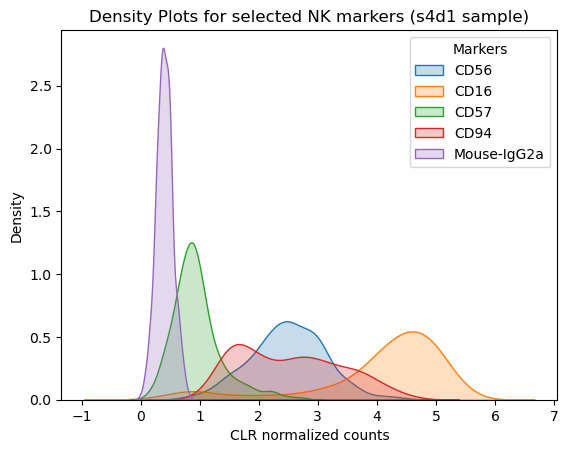

In [43]:
# List of markers to plot
markers = ['CD56', 'CD16', 'CD57', 'CD94', 'Mouse-IgG2a']

# Iterate through markers
for marker in markers:
    sns.kdeplot(df_comb[marker],
                fill=True,
                label = marker)
    
# Plot formatting
plt.legend(prop={'size': 10}, title = 'Markers')
plt.title('Density Plots for selected NK markers (s4d1 sample)')
plt.xlabel('CLR normalized counts')
plt.ylabel('Density')

In [44]:
#Neurips

column_names = neurips_nk_prot.columns

df = neurips_nk_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=0.2,
    kde_points=np.linspace(-5, 10, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=3 / 10,
)

fig.update_layout(
    title="Neurips, s4d1 sample",
    height = 2500,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

In [45]:
easi_nkt_prot.columns

Index(['CD19', 'CD10', 'CD20', 'CD3', 'CD2', 'CD11b', 'HLADR', 'CD38', 'CD11c',
       'CD7', 'CD45', 'CD33', 'CD81', 'CD73', 'CD123', 'CD14', 'CD45RA',
       'CD45RO', 'CD4', 'CD8a', 'CD197', 'CD127', 'CD56', 'CD5', 'CD15',
       'CD64', 'CD117', 'CD24', 'CD44', 'CD58', 'CD66ace', 'CD13', 'CD34'],
      dtype='object')

In [46]:
#Easigenomics, NK markers, selected sample (EG35)


column_names = ['CD7', 'CD56', 'CD34', 'CD38', 'CD127' ]
df = easi_nkt_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=0.5,
    kde_points=np.linspace(-5, 20, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.5,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="CLR",
    height=750,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

df = easi_nkt_dsb[column_names]
fig = ridgeplot(
    samples=df.values.T,
    bandwidth=0.5,
    kde_points=np.linspace(-10, 50, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.5,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="DSB",
    height=750,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="DSB normalized protein counts",
)
fig.show()

In [47]:
#Easigenomics, all markers
#here now also T cells included => fix! 


column_names = easi_nkt_prot.columns
df = easi_nkt_prot[column_names]

fig = ridgeplot(
    samples=df.values.T,
    bandwidth=0.3,
    kde_points=np.linspace(-2, 10, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="CLR",
    height=750,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="CLR normalized protein counts",
)
fig.show()

df = easi_nkt_dsb[column_names]
fig = ridgeplot(
    samples=df.values.T,
    bandwidth=0.5,
    kde_points=np.linspace(-5, 25, 400),
    colorscale="Blues",
    colormode="index",
    coloralpha=0.6,
    labels=column_names,
    spacing=5 / 8,
)

fig.update_layout(
    title="DSB",
    height=750,
    width=900,
    plot_bgcolor="rgba(255, 255, 255, 0.0)",
    xaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_gridcolor="rgba(0, 0, 0, 0.1)",
    yaxis_title="DSB normalized protein counts",
)
fig.show()